# Combined 

In [1]:
import os
import sys
print(sys.version)
sys.path.extend(['./COMMON_UTILS/'])

3.9.10 (main, Mar 17 2022, 21:35:59) 
[GCC 11.2.0]


In [2]:
import warnings
import pickle as pkl
from importlib import reload


import numpy as np
import matplotlib.pyplot as plt

import torch
import librosa

from tqdm.auto import tqdm
from IPython.display import display, Audio

In [3]:
from utils import plot_audio

from wasserstein_transformations import SmoothTransform, SmoothTransition

import tempo_align
reload(tempo_align)
from tempo_align import warpAudio, quantiseAudio

from drum_processor import getDownbeats
from drum_decomposition import getDecomposition, plotDecomposition, isolateSources

In [4]:
warnings.simplefilter('ignore')

plt.rcParams['figure.figsize'] = (15, 5)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'computing on {device}')

computing on cpu


In [5]:
def play(y, sr, **kwargs):
    display(Audio(y, rate=sr, **kwargs))

### Load Audio 

In [6]:
SRC = './PROCESSED/dem_bow'
# DST = './PROCESSED/neil_young'
DST = './PROCESSED/bowie_heroes'

# DST = './PROCESSED/stereofuse_casino_04'
# SRC = './PROCESSED/astrud_gilberto'

In [7]:
y_src, sr = librosa.load(os.path.join(SRC, 'DRUMS/drums.wav'), sr=44100)
y_dst, _ = librosa.load(os.path.join(DST, 'DRUMS/drums.wav'), sr=sr)
y_dst_full, _ = librosa.load(os.path.join(DST, 'source.wav'), sr=sr)

In [8]:
stems = []
for s in ['vocals', 'bass', 'other']:
    y_ins, _ = librosa.load(os.path.join(DST, s.upper(), f'{s}.wav'), sr=sr)
    stems.append(y_ins)
y_dst_ins = np.sum(stems, axis=0)

In [9]:
display(Audio(y_dst_ins, rate=sr))

In [10]:
tempo_src = librosa.beat.tempo(y=y_src, sr=sr)
tempo_dst = librosa.beat.tempo(y=y_dst, sr=sr)
print(tempo_src, tempo_dst)

[99.38401442] [112.34714674]


In [11]:
db_src = getDownbeats(
    os.path.join(SRC, 'source.wav'), 
    transition_lambda=64, 
    min_bpm=tempo_src*0.8,
    max_bpm=tempo_src*1.2
)

In [12]:
y_dst_ins, _  = quantiseAudio(y_dst_ins, sr, db_src, hq=True)
y_src, db_src = quantiseAudio(y_src, sr, db_src, hq=True)

In [13]:
db_dst = getDownbeats(
    os.path.join(DST, 'source.wav'), 
    transition_lambda=64, 
    min_bpm=tempo_dst*0.7,
    max_bpm=tempo_dst*1.3
)

In [14]:
# quantise beats
y_dst, db_dst = quantiseAudio(y_dst, sr, db_dst, hq=True)

In [15]:
y_src_metro = librosa.clicks(times=db_src, sr=sr, length=len(y_src))
y_dst_metro = librosa.clicks(times=db_dst, sr=sr, length=len(y_dst))

In [16]:
play(y_src + y_src_metro, sr)
play(y_dst + y_dst_metro, sr)

In [17]:
y_src_warped, y_dst_synced, downbeats, idxs_src, idxs_dst = warpAudio(
    y_src, y_dst, db_src, db_dst, sr
)

In [18]:
assert y_src_warped.shape == y_dst_synced.shape

In [19]:
y_ins_segment = y_dst_ins[idxs_dst[0]: idxs_dst[1]]

In [20]:
play(y_src_warped, sr, autoplay=False)
play(y_dst_synced, sr, autoplay=False)

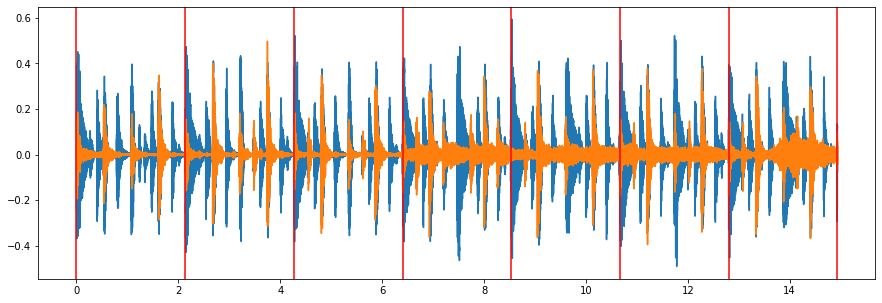

In [21]:
ax = plot_audio(y_src_warped, sr)
plot_audio(y_dst_synced, sr, ax=ax)
for db in downbeats:
    ax.axvline(db, color='red')

In [22]:
y_metronome = librosa.clicks(times=downbeats, sr=sr, length=len(y_dst_synced))

In [23]:
play(y_metronome + y_dst_synced, sr)

### Decompose Drums

In [214]:
with open('./drum_templates.pkl', 'rb') as f:
    templates = pkl.load(f)
    
kd_temp = templates['kd_temp']
sd_temp = templates['sd_temp']
hh_temp = templates['hh_temp']

W_0 = np.stack([kd_temp, sd_temp, hh_temp], axis=1)
W_0 = torch.from_numpy(W_0).to(device)

In [215]:
W_src, H_src, V_src, _, net_src = getDecomposition(
    y_src_warped, R=3, W=W_0, trainable_W=True
)

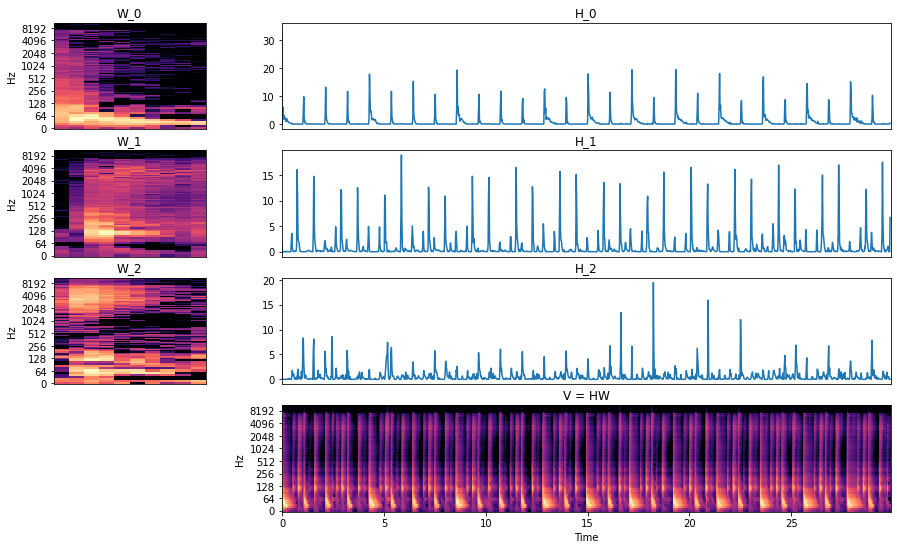

In [216]:
plotDecomposition(W_src, H_src, V_src)

In [217]:
W_dst, H_dst, V_dst, _, net_dst = getDecomposition(y_dst_synced, R=3, W=W_0)

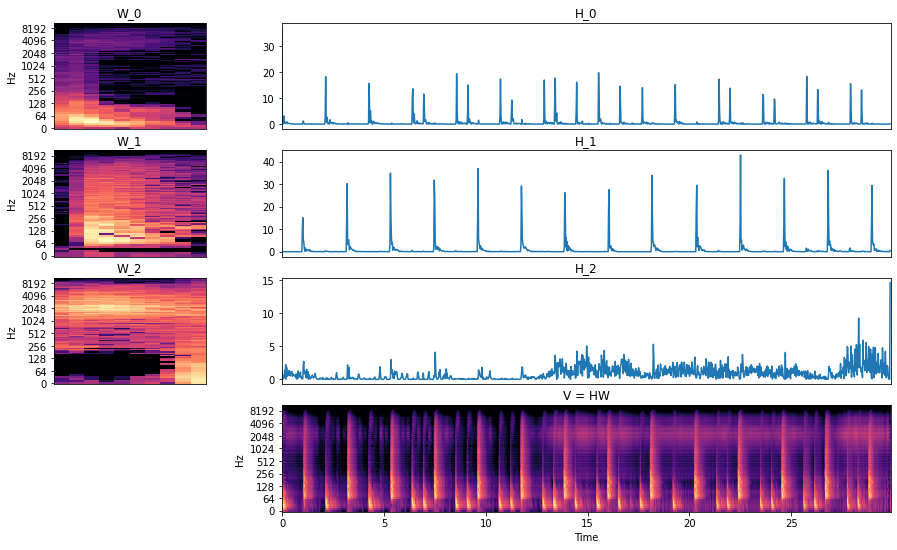

In [218]:
plotDecomposition(W_dst, H_dst, V_dst)

In [219]:
H_src.max(axis=1)

array([34.691334, 18.976372, 19.460014], dtype=float32)

In [220]:
H_dst.max(axis=1)

array([37.09701  , 43.019524 , 14.6502285], dtype=float32)

### Morph Activations 

#### Full Replacement

In [170]:
H_hat = torch.from_numpy(H_src)
for i in range(H_src.shape[0]):
    scale = net_dst.H[0, i].max() / H_src[i].max()
    H_hat[i] *= scale

In [171]:
V_hat = net_dst.reconstruct(
    net_dst.W, H_hat.unsqueeze(0)
).detach().cpu().squeeze().numpy()

In [172]:
y_r = librosa.griffinlim(V_hat)

In [173]:
y_final = np.sum([y_r, y_ins_segment[:len(y_r)]], axis=0)
y_final = y_r + y_ins_segment[:len(y_r)]

In [175]:
play(y_r, sr)
play(y_final, sr)

#### Threshold Transition 

In [178]:
# sms = [SmoothTransition(H_dst[i], H_src[i]) for i in range(3)]
sm = SmoothTransition(H_dst, H_src)

In [177]:
y_transformed = []
weights = np.linspace(0, 1, 5)

for t in tqdm(weights):
    H_w = torch.from_numpy(sm(t)).type(torch.float)
    
    for i in range(len(H_dst)):
        H_w[i] *= (H_dst[i].max() / H_w[i].max())
    
    V_w = net_dst.reconstruct(
        net_dst.W, H_w.unsqueeze(0)
    ).detach().cpu().squeeze().numpy()
    
    y_w = librosa.griffinlim(V_w)
    y_w_final = y_w + np.copy(y_ins_segment[:len(y_w)])
    y_transformed.append(y_w_final)

  0%|          | 0/5 [00:00<?, ?it/s]

In [180]:
for i, yt in enumerate(y_transformed):
    print(f'SRC transformed {weights[i]:.0%}')
    play(yt, sr)

SRC transformed 0%


SRC transformed 25%


SRC transformed 50%


SRC transformed 75%


SRC transformed 100%


#### Transition 

In [494]:
import wasserstein_transformations
reload(wasserstein_transformations)
from wasserstein_transformations import SmoothTransform, SmoothTransition

In [495]:
db_frames = librosa.time_to_frames(downbeats, sr=sr)[1:]
db_samples = librosa.time_to_samples(downbeats, sr=sr)[1:]

In [496]:
H_src_bars = np.split(H_src, db_frames, axis=1)   # (bar_num, ins, frame)
H_dst_bars = np.split(H_dst, db_frames, axis=1)   # (bar_num, ins, frame)
y_src_bars = np.split(y_src_warped, db_samples)   # (bar_num, samples)
y_dst_bars = np.split(y_dst_synced, db_samples)   # (bar_num, samples)

In [497]:
idx = 0
H_start = H_dst_bars[idx]
H_end = H_src_bars[idx]

In [498]:
sm = SmoothTransition(H_start, H_end, H_dst.max(axis=1).reshape((-1, 1)), H_src.max(axis=1).reshape((-1, 1)))

In [499]:
play(y_src_bars[idx], sr)
play(y_dst_bars[idx], sr)

In [519]:
transition = []
weights = np.linspace(0, 1, 7)
for t in tqdm(weights):
    H_w = sm(t, power=2, score_threshold=0.1)
    transition.append(H_w)
H_t = np.concatenate(transition, axis=1)

  0%|          | 0/7 [00:00<?, ?it/s]

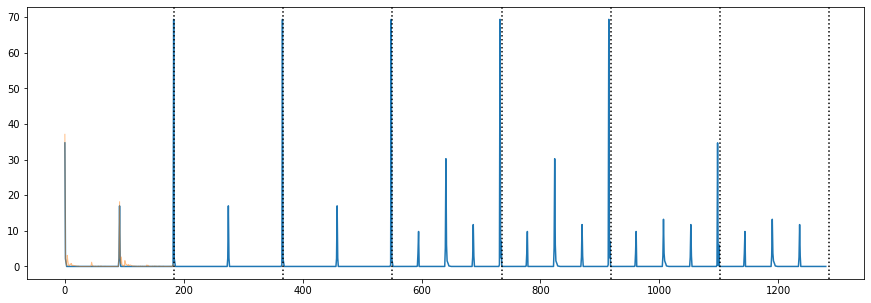

In [520]:
plt.plot(H_t[0]);
plt.plot(H_start[0], lw=1, alpha=0.5)
for db in db_frames[:len(transition)]:
    plt.axvline(db, c='k', ls=':')

In [521]:
H_t = torch.from_numpy(H_t).type(torch.float)

In [522]:
V_t = net_dst.reconstruct(
        net_dst.W, H_t.unsqueeze(0)
    ).detach().cpu().squeeze().numpy()

In [523]:
y_transitioning = librosa.griffinlim(V_t, momentum=0.99)

In [524]:
transition_beeps = librosa.clicks(
    times=downbeats, sr=sr, length=len(y_transitioning)
) * 0.25

In [525]:
play(y_transitioning, sr)

## Full Track Transition 

In [526]:
H_transition_full = torch.from_numpy(np.concatenate([
    H_start,
    H_start,
    H_start,
    H_t,
    H_end,
    H_end,
    H_end,
    H_end,
    H_end,
], axis=1)).type(torch.float)

In [527]:
V_transition_full = net_dst.reconstruct(
        net_dst.W, H_transition_full.unsqueeze(0)
    ).detach().cpu().squeeze().numpy()
y_transitioning_full = librosa.griffinlim(V_transition_full)

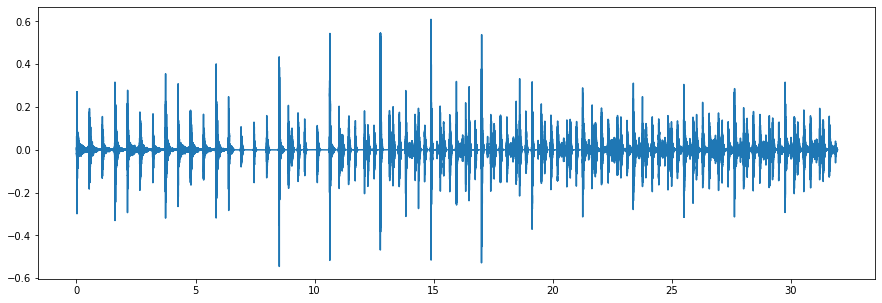

In [528]:
plot_audio(y_transitioning_full, sr)
play(y_transitioning_full, sr)

In [529]:
y_ins_synced = y_dst_ins[idxs_dst[0]:]

In [531]:
full_length = min(len(y_ins_synced), len(y_transitioning_full))
y_full_transition = y_ins_synced[:full_length] + y_transitioning_full[:full_length]

In [532]:
play(y_full_transition, sr)

#### Percent Transformed 

In [37]:
import wasserstein_transformations
reload(wasserstein_transformations)
from wasserstein_transformations import SmoothTransform, SmoothTransition

In [38]:
sm = SmoothTransform(steps=5)

In [39]:
sm.weights

array([0.  , 0.25, 0.5 , 0.75, 1.  ])

In [40]:
transformations = []
for i in range(len(H_dst)):
    ps, qs = H_src[i], H_dst[i]
    ps, qs = ps/ps.max(), qs/qs.max()
    
    trans = sm.transform(ps, qs)
    transformations.append(trans)

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
sm.plot_transform(transformations[1])
plt.show()

In [ ]:
y_transformed = []

for w in tqdm(range(len(transformations[0]))):
    H_w = torch.from_numpy(
        np.stack(
            [transformations[i][w] for i in range(len(transformations))]
        )
    ).type(torch.float)
    
    # rescale activations from probability dist
    for i in range(len(H_dst)):
        H_w[i] *= (H_dst[i].max() / H_w[i].max())

    V_w = net_dst.reconstruct(
        net_dst.W, H_w.unsqueeze(0)
    ).detach().cpu().squeeze().numpy()

    y_w = librosa.griffinlim(V_w)
    y_w_final = y_w + np.copy(y_ins_segment[:len(y_w)])
    y_transformed.append(y_w_final)

In [ ]:
for i, yt in enumerate(y_transformed):
    print(f'SRC transformed {sm.weights[i]:.0%}')
    play(yt, sr)